# He Adsorption Isotherm

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from pimcscripts import pimchelp
from collections import defaultdict
import scipy.constants as constants


import importlib

from dgutils import colors as colortools
import dgutils

%config InlineBackend.figure_format = 'svg'

# plot style
plot_style = {'sans':'../include/sans.mplstyle', 'notebook':'../include/notebook.mplstyle'}
plt.style.reload_library()
plt.style.use(plot_style['notebook'])

figsize = plt.rcParams['figure.figsize']

π = np.pi
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

In [2]:
import poreutils as pore
importlib.reload(pore)

from poreutils import red,orange,green,lblue,blue,dblue,purple
from poreutils import pore_colors,pore_labels,font_path

## Paul's Experimental Isotherms


### Ar/MCM-41

In [4]:
isotherm = {}
isotherm['He/Ar/MCM41'] = np.loadtxt('../data/Sokol_He_Ar_MCM41_Isotherm.dat')
cT = 4.2 # K

# we interpolate to find fillings at layer completion
from scipy.interpolate import interp1d
n = interp1d(isotherm['He/Ar/MCM41'][5:,0],isotherm['He/Ar/MCM41'][5:,1],kind='cubic', fill_value="extrapolate")

# invert the function
from pynverse import inversefunc
PoP0 = inversefunc(n)

# maximal filling observed
fill_max = 13

## Results for QMC Simulations of 4He inside a single pore
|layer    |  radius   | atoms     |      total_in_pore|
|---------|------------|----------|-------------------| 
|Layer_1   | 9.0      | 283.78831611    |283.7883161127810|
|Layer_2   | 6.2      | 182.22542945    |466.0137455666848|
|Layer_3   | 3.2      | 86.089146840    |552.1028924043874|
|Core      | 0.0      | 13.431193880    |565.5340862807204|

In [5]:
filled_N = 570.08863 # the maximum number of particles ever observed for this pore
filling_fraction = [283.78831611/filled_N, 466.0137455666848/filled_N, 552.1028924043874/filled_N,565.5340862807204/filled_N]

In [6]:
#red = '#BB0000'
atom_colors = [red,orange,green,lblue]

In [7]:
def add_inset_image(fig,ax,image_file, left=0.0, bottom=0.0, width=0.25):
    
    im = plt.imread(image_file,format='png')
    
    #inv = ax.transData.inverted()
    #print(inv.transform([left,bottom]))
    
    #X0, Y0 = fig.transFigure.transform([left,bottom]).inverted()
    #print(X0,Y0)
    
    ax_coords = [left,bottom,width,im.shape[0]/im.shape[1]*width]
    newax = fig.add_axes(ax_coords)
    #newax = ax.inset_axes(ax_coords)
    newax.imshow(im,interpolation='none')
    newax.axis('off')
    #ax[1].annotate(r'$z$', xy=(3.375,260),xytext=(3.375, 260), 
     #                       xycoords='data', ha='right', va='top')
    

In [8]:
def plot_isotherm(_ax):   
    _ax.plot(isotherm['He/Ar/MCM41'][:,0],isotherm['He/Ar/MCM41'][:,1],'o',ms=4, mec='#000000', mew=0.5,
            mfc=colortools.get_alpha_hex('#000000',0.5), label='$^4$He/Ar/MCM-41')
    
    for i,cn in enumerate(filling_fraction):
        _ax.plot(PoP0(fill_max*cn),fill_max*cn, '*', ms=6, mec=atom_colors[i], 
               mfc=colortools.get_alpha_hex(atom_colors[i],0.5))
        
    _ax.plot(PoP0(fill_max),fill_max, 'D', ms=3, mec=purple, mew=0.5,mfc=colortools.get_alpha_hex(purple,0.1))
            
    _ax.set_xlabel(r'Pressure $\ P/P_0$')
    _ax.set_ylabel(r'Filling $\ n$ (mmol/g)')
    _ax.legend(loc=(0.64,0.0))
    
    _ax.set_ylim(0,20.5)
    _ax.set_xlim(0,1.03)
    
    #plt.savefig('../figures/He_Ar_MCM41_isotherm.svg')

    
def plot_isotherm_with_confgs(_fig,_ax):

    plot_isotherm(_ax)
    
    add_inset_image(_fig,_ax,'../figures/MCM41_Ar_feather.png', left=0.07,bottom=0.18, width=0.36)
    _ax.plot([0,0.1],[0,3], lw=1.0, ls=':', color='#000000', alpha=0.5)
    _ax.annotate('Ar', xy=(0.1,5.5), xytext=(0.155,4.9), arrowprops=dict(arrowstyle="->",color='#999999',lw=0.5, shrinkA=0),
                  xycoords='data', fontsize=6, ha='left', va='center', color='#999999')
    _ax.annotate('', xy=(0.235,2), xytext=(0.295,1), arrowprops=dict(arrowstyle="->",color='#7a0000',lw=0.5, shrinkA=0),
                  xycoords='data',fontsize=6, ha='left', va='top', color='#7a0000')
    _ax.text(0.3,0.5,'MCM-41',fontsize=6, ha='left', va='bottom', color='#7a0000')

    add_inset_image(_fig,_ax,'../figures/config_mu_-047.000.png', left=0.02,bottom=0.70, width=0.36)
    x,y = PoP0(fill_max*filling_fraction[0]),fill_max*filling_fraction[0]
    _ax.plot([x,0.1],[y,16], lw=1.0, ls=':', color=red, alpha=0.5)
    _ax.annotate('$^4$He', xy=(0.158,17), xytext=(0.22,19), arrowprops=dict(arrowstyle="->",color=red,lw=0.5, shrinkA=4,patchA=None),
                  xycoords='data', fontsize=6, ha='left', va='center', color=red)
    _ax.annotate('', xy=(0.328,17), xytext=(0.27,18.65), arrowprops=dict(arrowstyle="->",color=orange,lw=0.5, shrinkA=0,patchA=None),
                  xycoords='data', fontsize=6, ha='left', va='center', color=orange)

    add_inset_image(_fig,_ax,'../figures/config_mu_-027.000.png', left=0.25,bottom=0.70, width=0.36)
    x,y = PoP0(fill_max*filling_fraction[1]),fill_max*filling_fraction[1]
    _ax.plot([x,0.37],[y,17], lw=1.0, ls=':', color=orange, alpha=0.5)
    
    add_inset_image(_fig,_ax,'../figures/config_mu_-019.000.png', left=0.30,bottom=0.32, width=0.36)
    x,y = PoP0(fill_max*filling_fraction[2]),fill_max*filling_fraction[2]
    _ax.plot([x,0.45],[y,7], lw=1.0, ls=':', color=green, alpha=0.5)
    
    add_inset_image(_fig,_ax,'../figures/config_mu_-007.000.png', left=0.55,bottom=0.32, width=0.36)
    x,y = PoP0(fill_max*filling_fraction[3]),fill_max*filling_fraction[3]
    _ax.plot([x,0.75],[y,7], lw=1.0, ls=':', color=lblue, alpha=0.5)
    
    
plt.style.reload_library()
with plt.style.context(plot_style['sans']):
    
    figsize = plt.rcParams['figure.figsize']
    fig,ax = plt.subplots(figsize=(figsize[0],figsize[1]),constrained_layout=True)
    dgutils.fonts.set_custom_font(font_path)
    plot_isotherm_with_confgs(fig,ax)
   
    plt.savefig('../figures/He_Ar_MCM41_isotherm.pdf')

### Add the Radial Density Configurations

In [9]:
cT = 1.6
radρ = pimchelp.PIMCResults(f'../data/radial-u-reduce-T-{cT:06.3f}-t-0.00400-L-050.000.dat')

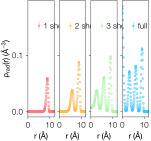

In [10]:
def ukey(μ):
    return f'u = {μ:4.2f}'
def μkey(μ):
    return f'μ = {μ} K'

def plot_radial_density_square(_fig):    
    axd = _fig.subplots(nrows=2,ncols=2, sharex=True, sharey=True)
    _fig.subplots_adjust(wspace=0.05,hspace=0.05)

    
    axd = axd.flat

    for i,cμ in enumerate([-47.0,-27.0,-19.0,-7.00]):
        label=f'$\mu = {cμ:4.1f}\; \mathrm{{K}}$'
        label = pore_labels[μkey(cμ)]
        axd[i].errorbar(*radρ.epdata(ukey(cμ)),**pore.get_props(pore_colors[μkey(cμ)],ls='--'), label=label)
        axd[i].legend()
        
    axd[0].set_xlim(0,12)
    axd[-2].set_xlabel(r'$r\; (\mathrm{\AA})$')
    axd[-1].set_xlabel(r'$r\; (\mathrm{\AA})$')
    
    axd[0].set_ylabel(r'$\rho(r)\; (\mathrm{\AA}^{-3})$')
    axd[-2].set_ylabel(r'$\rho(r)\; (\mathrm{\AA}^{-3})$')
    
def plot_radial_density_row(_fig):    
    axd = _fig.subplots(nrows=1,ncols=4, sharex=True, sharey=True)    
    axd = axd.flat

    for i,cμ in enumerate([-47.0,-27.0,-19.0,-7.00]):
        label=f'$\mu = {cμ:4.1f}\; \mathrm{{K}}$'
        label = pore_labels[μkey(cμ)]
        axd[i].errorbar(*radρ.epdata(ukey(cμ)),**pore.get_props(pore_colors[μkey(cμ)]), label=label)
        axd[i].legend(loc=(0.15,0.72), handletextpad=0.05)
        axd[i].set_xlabel(r'$r\; (\mathrm{\AA})$')

        
    axd[0].set_xlim(0,12)    
    axd[0].set_ylabel(r'$\rho_{\rm rad}(r)\; (\mathrm{\AA}^{-3})$')
    return axd

plt.style.reload_library()
with plt.style.context(plot_style['sans']):
    
    figsize = plt.rcParams['figure.figsize']
    fig = plt.figure(figsize=(figsize[1],figsize[1]),constrained_layout=False)
    dgutils.fonts.set_custom_font(font_path)
    plot_radial_density_row(fig)

## Build the Combined Figure

In [11]:
plt.style.reload_library()
with plt.style.context(plot_style['sans']):
    
    dgutils.fonts.set_custom_font(font_path)

    figsize = plt.rcParams['figure.figsize']
    fig = plt.figure(figsize=(figsize[0],1.5*figsize[1]), constrained_layout=True)
    iso_fig,rad_fig = fig.subfigures(nrows=2,ncols=1, height_ratios=[2,1])
    ax_iso = iso_fig.subplots(1,1)
    
    plot_isotherm_with_confgs(iso_fig,ax_iso)
    ax_rad = plot_radial_density_row(rad_fig)
    
    # add panel labels
    font_props = dgutils.fonts.get_custom_font_props(pore.bold_font_path)
    ax_iso.text(-0.11,1.0,'a', ha='left',va='top', transform=ax_iso.transAxes, fontproperties=font_props)
    #ax_rad[0].text(-0.6,1.08,'b', ha='left',va='top', transform=ax_rad[0].transAxes, fontproperties=font_props)
    fig.text(0.015,0.35,'b', ha='left',va='top',fontproperties=font_props)
    
    # add shell labels
    ax_rad[-1].text(0.9,0.13,"core", fontsize=5)
    ax_rad[-1].text(2.9,0.075,r"$1^{\rm st}$", fontsize=5)
    ax_rad[-1].text(5.8,0.085,r"$2^{\rm nd}$", fontsize=5)
    ax_rad[-1].text(8.7,0.118,r"$3^{\rm rd}$", fontsize=5)

    plt.savefig('../figures/He_Ar_MCM41_isotherm_radial.pdf')